In [1]:
import geopandas as gp
import folium
from shapely import geometry as gm
import itertools
from polygon_geohasher.polygon_geohasher import polygon_to_geohashes, geohashes_to_polygon
import pandas as pd
pd.set_option('display.max_columns',None)


## Determining Inaccessible Public Lands

### Datasets
Public land datasets can be found at https://www.sciencebase.gov/catalog/item/62226321d34ee0c6b38b6be3 which comes from the PAD-US files, you can learn more about PAD-US dataset here, https://www.usgs.gov/programs/gap-analysis-project/science/pad-us-data-overview.

The roads dataset comes from USGS and The National Map. The dataset is here https://prd-tnm.s3.amazonaws.com/StagedProducts/Tran/Shape/TRAN_Wyoming_State_Shape.zip and you can learn more about the transportation dataset here https://www.sciencebase.gov/catalog/item/5a61c942e4b06e28e9c3bddc

### Motiviation
The motivation to provide this analysis stems from a recent corner crossing case (https://wyofile.com/ranch-owner-corner-crossing-damages-could-exceed-7m/). HuntScore is providing this analysis and code as a means to help promote solutions to making public land accessible. In particular, an incosequential amount of public land is either entirely surrounded by private land or requires access via corner hopping (a still legal gray area). Hopefully this analysis and code can be used as a starting point to prioritize access through either public or private initiative.

### Potential Uses
Hopefully this notebook serves as an example of how to identify different access modes by using graph networks. In addition, the graph structure could be useful to weight potential access paths, where more than one exists, to provide access to the optimal amount of public land. 

While the legality of corner crossing works its way through Federal court, there could many uses depending on the outcome. If found legal with a narrow prescriptive ruling where persons crossing a corner must be certain of the corner, the analysis could be used to identify the largest tracts of public land that could be accessible through corner crossing and help prioritize the placement of visible survey corners along the access paths. On other hand, if corner crossing is found to be illegal unless consent is obtained by all bordering property owners, a private or public entity could work to negotiate access with private property owners corners by merging in a private landowner dataset to this one.

## Load Wyoming Public Land

In [2]:
wyland = gp.read_file('/Users/mhabiger/Downloads/PADUS3_0_State_WY_SHP/PADUS3_0Fee_StateWY.shp')

In [3]:
wyland.head(3)

,FeatClass,d_FeatClas,Category,d_Category,Own_Type,d_Own_Type,Own_Name,d_Own_Name,Loc_Own,Mang_Type,d_Mang_Typ,Mang_Name,d_Mang_Nam,Loc_Mang,Des_Tp,d_Des_Tp,Loc_Ds,Unit_Nm,Loc_Nm,State_Nm,d_State_Nm,Agg_Src,GIS_Src,Src_Date,GIS_Acres,Source_PAI,WDPA_Cd,Pub_Access,d_Pub_Acce,Access_Src,Access_Dt,GAP_Sts,d_GAP_Sts,GAPCdSrc,GAPCdDt,IUCN_Cat,d_IUCN_Cat,IUCNCtSrc,IUCNCtDt,Date_Est,Comments,SHAPE_Leng,SHAPE_Area,geometry
0,Fee,Fee,Fee,Fee,FED,Federal,BLM,Bureau of Land Management,None,FED,Federal,BLM,Bureau of Land Management,BLM,PUB,National Public Lands,None,Billings Field Office,Billings Field Office,WY,Wyoming,USGS_PADUS3_0Fee_BLM_SMA_ADMU_Union,SMA_for_PADUS_20210120_1.gdb\SurfaceManagement...,2021/06/11,1,None,0,OA,Open Access,GAP - Default,2021,3,3 - managed for multiple uses - subject to ext...,GAP - Default,2021,Other Conservation Area,Other Conservation Area,GAP - Default,2021,None,None,1.688651e+04,2.326939e+03,"MULTIPOLYGON (((-964334.087 2508139.311, -9643..."
1,Fee,Fee,Fee,Fee,FED,Federal,BLM,Bureau of Land Management,None,FED,Federal,BLM,Bureau of Land Management,BLM,PUB,National Public Lands,None,Billings Field Office,Billings Field Office,WY,Wyoming,USGS_PADUS3_0Fee_BLM_SMA_ADMU_Union,SMA_for_PADUS_20210120_1.gdb\SurfaceManagement...,2021/06/11,0,None,0,OA,Open Access,GAP - Default,2021,3,3 - managed for multiple uses - subject to ext...,GAP - Default,2021,Other Conservation Area,Other Conservation Area,GAP - Default,2021,None,None,7.044126e+03,8.331714e+02,"MULTIPOLYGON (((-864957.100 2495472.292, -8649..."
2,Fee,Fee,Fee,Fee,FED,Federal,BLM,Bureau of Land Management,None,FED,Federal,BLM,Bureau of Land Management,BLM,PUB,National Public Lands,None,Buffalo Field Office,Buffalo Field Office,WY,Wyoming,USGS_PADUS3_0Fee_BLM_SMA_ADMU_Union,SMA_for_PADUS_20210120_1.gdb\SurfaceManagement...,2021/06/11,867546,None,0,OA,Open Access,GAP - Default,2021,3,3 - managed for multiple uses - subject to ext...,GAP - Default,2021,Other Conservation Area,Other Conservation Area,GAP - Default,2021,None,None,8.825345e+06,3.510835e+09,"MULTIPOLYGON (((-733353.658 2316434.437, -7333..."


In [4]:
wyland.groupby('d_Own_Name').GIS_Acres.sum().sort_values(ascending=False)

d_Own_Name
Bureau of Land Management            17804113
Forest Service                        9226163
State Land Board                      3561307
National Park Service                 2330195
Bureau of Reclamation                  904445
State Fish and Wildlife                388974
U.S. Fish and Wildlife Service          65271
Non-Governmental Organization           31197
State Park and Recreation               18593
Other or Unknown State Land             14877
City Land                               12548
County Land                              7548
Private                                  1105
Other or Unknown Local Government         420
Regional Agency Land                      389
Joint                                       9
Name: GIS_Acres, dtype: int64

In [5]:
wyland = wyland[['Own_Name','geometry']]

In [6]:
wyland['geometry1'] = wyland.geometry.to_crs({'init': 'epsg:4269'})
wyland['geometry'] = wyland.geometry

/Users/mhabiger/anaconda3/envs/basic_huntscore/lib/python3.8/site-packages/pyproj/crs/crs.py:130: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)


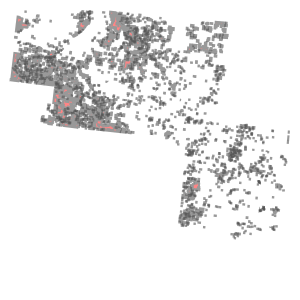

In [7]:
wyland.geometry.values[3]

<br>

#### An example of mapping a parcel. Currently the dataset has mulitpolygons which we will turn into individual polygons below.

In [8]:
osm = folium.Map([42.994,-105.590],zoom_start=8)
folium.GeoJson(gm.mapping(wyland.geometry1.values[3])).add_to(osm)
osm

In [9]:
wyland.crs

<Derived Projected CRS: ESRI:102039>
Name: USA_Contiguous_Albers_Equal_Area_Conic_USGS_version
Axis Info [cartesian]:
- [east]: Easting (metre)
- [north]: Northing (metre)
Area of Use:
- undefined
Coordinate Operation:
- name: unnamed
- method: Albers Equal Area
Datum: North American Datum 1983
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

## Load Road Network For Wyoming

In [10]:
wyroads1 = gp.read_file('/Users/mhabiger/Downloads/TRAN_Wyoming_State_Shape/Shape/Trans_RoadSegment.shp')
wyroads2 = gp.read_file('/Users/mhabiger/Downloads/TRAN_Wyoming_State_Shape/Shape/Trans_TrailSegment.shp')

<br>

According to technical documentation,  https://www2.census.gov/geo/pdfs/maps-data/data/tiger/tgrshp2022/TGRSHP2022_TechDoc_E.pdf, private roads are classified as mtfcc_code S1740. So we will exclude these roads from the analysis. S1400 & S1500 could also include private roads which may be closed to travel.

In [11]:
wyroads1.head(3)

,permanent_,source_fea,source_dat,source_d_1,source_ori,loaddate,interstate,us_route,state_rout,county_rou,federal_la,stco_fipsc,tnmfrc,name,mtfcc_code,intersta_1,intersta_2,intersta_3,us_route_a,us_route_b,us_route_c,state_ro_1,state_ro_2,state_ro_3,SHAPE_Leng,ObjectID,geometry
0,a631e3a3-278a-49d2-a2c9-f32b8721b8ce,1106073895730,{84D2183D-8BB4-4DBB-8848-8FBC90DB5400},2017 July MAFTIGER,"U.S. Department of Commerce, U.S. Census Burea...",2017-09-28,None,None,None,None,None,56031,4,S Guernsey Rd,S1400,None,None,None,None,None,None,None,None,None,0.000469,1,"LINESTRING (-104.74206 42.25903, -104.74207 42..."
1,ae22f312-e2b7-4b90-a18b-4f8611272d9a,1105058887284,{AD68E48A-6BC8-4301-A05A-3336BCEE0E46},USFS Roads 04/2021,U.S. Forest Service,2021-07-20,None,None,None,None,None,56001,4,None,S1400,None,None,None,None,None,None,None,None,None,0.004127,2,"LINESTRING (-105.47860 42.18840, -105.47854 42..."
2,{5BF6CFD8-FC58-4F2E-9974-2804BCFD2582},1105616797687,{AD68E48A-6BC8-4301-A05A-3336BCEE0E46},USFS Roads 04/2021,U.S. Forest Service,2021-07-20,None,None,None,None,None,56005,4,None,S1400,None,None,None,None,None,None,None,None,None,0.001327,3,"LINESTRING (-105.35928 43.60689, -105.35864 43..."


In [12]:
wyroads1['length'] = wyroads1.geometry.to_crs({'init': 'epsg:5070'}).map(lambda x: x.length)
wyroads1.groupby('mtfcc_code').length.sum().sort_values(ascending=False)

/Users/mhabiger/anaconda3/envs/basic_huntscore/lib/python3.8/site-packages/pyproj/crs/crs.py:130: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)


mtfcc_code
S1400    1.685824e+08
S1500    3.052548e+07
S1200    9.761618e+06
S1740    8.434520e+06
S1100    2.938931e+06
S1630    3.536253e+05
S1640    1.334003e+05
Name: length, dtype: float64

<br>

### Spoiler Alert!
From the above calculation we can see that roads classified as "private" account for 8.4 million meters (~5240 miles) of road.
Other <b>possibly</b> private roads are S1400 and S1500 classes. These roads account for the majority of roadway length in Wyoming! For now we will exclude S1500 and S1740 roads in this analysis. 

However, from personal experience, I can say that a number of S1400 classified road segments are also private or at least appear private because a sign is posted. Running this notebook with varying mtfcc exclusions will find that Wyoming has potentially between 500,000 to 8 million acres of landlocked land. Determining which segments are public, private or private with a public easement is one of the things the MAPLand Act aims to solve (https://www.congress.gov/bill/117th-congress/house-bill/3113). 


In [15]:
wyroads1 = wyroads1[~wyroads1.mtfcc_code.isin(['S1740','S1500'])][['permanent_','geometry']]
wyroads1.columns = ['id','geometry']

In [16]:
wyroads2.head(3)

,permanenti,name,namealtern,trailnumbe,trailnum_1,sourcefeat,sourcedata,sourceda_1,sourceorig,loaddate,trailtype,hikerpedes,bicycle,packsaddle,atv,motorcycle,ohvover50i,snowshoe,crosscount,dogsled,snowmobile,nonmotoriz,motorizedw,primarytra,nationaltr,lengthmile,networklen,SHAPE_Leng,ObjectID,geometry
0,31a64787-fae9-48b3-9edc-2de76087d48b,Mountain Creek Trail,None,None,None,Yellowstone National Park,{A2B9A873-ACAC-4D1C-B014-5B090D31938D},NPS Trails Update 12/2021,National Park Service,2022-01-03,Terra Trail,Y,N,N,N,N,N,N,N,N,N,None,None,NPS,None,1.873593,3172.813923,0.031692,1,"LINESTRING (-110.00437 44.32412, -110.00360 44..."
1,7c1ded41-f5d8-4dc7-8f58-d9fc6c41c64b,Mountain Creek Trail,None,None,None,Yellowstone National Park,{A2B9A873-ACAC-4D1C-B014-5B090D31938D},NPS Trails 10/2019,National Park Service,2019-12-09,Terra Trail,Y,N,N,N,N,N,N,N,N,N,None,None,NPS,None,1.436181,3172.813923,0.022422,2,"LINESTRING (-110.00298 44.30561, -110.00326 44..."
2,57498dbd-a463-49a9-a21f-a0bf29137c8a,Mountain Creek Trail,None,None,None,Yellowstone National Park,{A2B9A873-ACAC-4D1C-B014-5B090D31938D},NPS Trails 10/2019,National Park Service,2019-12-09,Terra Trail,Y,N,N,N,N,N,N,N,N,N,None,None,NPS,None,1.315874,3172.813923,0.025116,3,"LINESTRING (-110.08309 44.23790, -110.08282 44..."


In [17]:
wyroads2 = wyroads2[['permanenti','geometry']]
wyroads2.columns = ['id','geometry']

In [18]:
roads = pd.concat([wyroads1,wyroads2])

In [19]:
roads.crs

<Geographic 2D CRS: EPSG:4269>
Name: NAD83
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: North America - onshore and offshore: Canada - Alberta; British Columbia; Manitoba; New Brunswick; Newfoundland and Labrador; Northwest Territories; Nova Scotia; Nunavut; Ontario; Prince Edward Island; Quebec; Saskatchewan; Yukon. Puerto Rico. United States (USA) - Alabama; Alaska; Arizona; Arkansas; California; Colorado; Connecticut; Delaware; Florida; Georgia; Hawaii; Idaho; Illinois; Indiana; Iowa; Kansas; Kentucky; Louisiana; Maine; Maryland; Massachusetts; Michigan; Minnesota; Mississippi; Missouri; Montana; Nebraska; Nevada; New Hampshire; New Jersey; New Mexico; New York; North Carolina; North Dakota; Ohio; Oklahoma; Oregon; Pennsylvania; Rhode Island; South Carolina; South Dakota; Tennessee; Texas; Utah; Vermont; Virginia; Washington; West Virginia; Wisconsin; Wyoming. US Virgin Islands. British Virgin Islands

<br>
We'll need to map some geometries but also want to be able to compare in 2D so we project to AEA

In [20]:
roads['geometry1'] = roads.geometry.to_crs({'init': 'epsg:5070'})

/Users/mhabiger/anaconda3/envs/basic_huntscore/lib/python3.8/site-packages/pyproj/crs/crs.py:130: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)


## Step 1) Lets determine which parcels of public land share a common boundary and which only share a corner

First we need to get down to individuals polygons. We explode multipolygon objects

In [21]:
wyland.shape

(19761, 3)

In [22]:
wyland = wyland.explode('geometry')

In [23]:
wyland.shape

(33050, 3)

In [24]:
wyland = wyland.reset_index()

<br> 

Next, we will generate geohashes to speed up computations. If you aren't familiar with a geohash just google it. It's one of many ways to create a geospatial index that allows partitioning for fast lookup.

In [25]:
wyland['geometry1'] = wyland.geometry
wyland['geometry'] = wyland.geometry.to_crs({'init': 'epsg:4269'})

/Users/mhabiger/anaconda3/envs/basic_huntscore/lib/python3.8/site-packages/pyproj/crs/crs.py:130: FutureWarning: '+init=<authority>:<code>' syntax is deprecated. '<authority>:<code>' is the preferred initialization method. When making the change, be mindful of axis order changes: https://pyproj4.github.io/pyproj/stable/gotchas.html#axis-order-changes-in-proj-6
  in_crs_string = _prepare_from_proj_string(in_crs_string)


In [26]:
wyland['geohashes'] = wyland.geometry.map(lambda x: list(polygon_to_geohashes(x, 4, False)))

In [27]:
wyland = wyland.explode('geohashes')

<br>

Then we explode on geohashes. The whole purpose is to allow us to compare small chunks of geospatial data rather than the entire set. We don't need to compare a polygon on the Western side of the state to a polygon on the Eastern side of the state and this allows us to compare polygons that are only close.

In [28]:
wyland['acres'] = wyland.geometry1.map(lambda x: x.area*0.000247105)

In [29]:
wyland.shape

(36277, 7)

<br>

This index will come in handy later as it allows us to identify a unique polygon. Given there may currently be duplicates but we can handle that in calculations as needed.

In [30]:
wyland['id'] = wyland.level_0.astype(str)+'_'+wyland.level_1.astype(str)

<br>

Let's map the 50 largest polygons in the dataset.

In [31]:
osm = folium.Map([42.994,-105.590],zoom_start=6)
mapped = []
n = 0
for i in wyland.sort_values('acres',ascending=False).itertuples():
    if i.id not in mapped:
        if n<50:
            folium.GeoJson(gm.mapping(i.geometry)).add_to(osm)
            mapped.append(i.id)
            n+=1
osm

In [32]:
geoms = {}
for grp,v in wyland.groupby('geohashes'):
    geoms[grp]=v

In [33]:
def shared_boundary(geom, geoms, ghash):
    single = []
    multi = []
    for rec in geoms[ghash].itertuples():
        if not geom.disjoint(rec.geometry):
            if isinstance(geom.intersection(rec.geometry),gm.Point):
                single.append(rec.id)
            else:
                multi.append(rec.id)
    return single,multi

wyland[['touches','borders']] = wyland.apply(lambda x: shared_boundary(x.geometry, geoms, x.geohashes), axis=1, result_type='expand')



## Step 2) Let's which public land parcels intersect roads and therefore are accessible.

In [34]:
roads['geohashes'] = roads.geometry.map(lambda x: list(polygon_to_geohashes(x, 4, False)))

In [35]:
roads.shape

(269258, 4)

In [36]:
roads = roads.explode('geohashes')

In [37]:
roads.shape

(278835, 4)

<br>

We build a 5m buffer around road just in case it's close to a parcel. If we assume the road coordinates (may be a bad assumption), then this seems like very reasonable buffer.

In [38]:
roads['geometry1'] = roads.geometry1.buffer(5)

In [39]:
road_geoms = {}
for grp,v in roads.groupby('geohashes'):
    road_geoms[grp]=v

In [41]:
def access(geom, geoms, ghash):
    if ghash in geoms:
        for rec in geoms[ghash].itertuples():
            if not geom.disjoint(rec.geometry1):
                return True
    return False

wyland['access'] = wyland.apply(lambda x: access(x.geometry1, road_geoms, x.geohashes), axis=1)

<br>

Now
because we have multiple instances of the same polygon due to our geohashing, we need to true up the access column. So we check if any hash has access and then set access to true for all instances of that id.

In [42]:
acc = wyland[wyland.access].id.unique()
wyland['access'][wyland.access==False] = wyland[wyland.access==False].id.map(lambda x: True if x in acc else False)

/var/folders/8q/mn71drbx77l56t22gpx3kf840000gn/T/ipykernel_11683/1112493143.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  wyland['access'][wyland.access==False] = wyland[wyland.access==False].id.map(lambda x: True if x in acc else False)
/Users/mhabiger/anaconda3/envs/basic_huntscore/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)


<br>

Just how many parcels have direct road access? And how many acres are directly accessible because a road intersects the parcel?

In [43]:
wyland.access.value_counts() 

True     18862
False    17415
Name: access, dtype: int64

In [44]:
wyland[(wyland.access==True)][['id','acres']].drop_duplicates().acres.sum()

32013323.757573288

## Step 3) Identify and Classify additional access via graph networks. 

### We will identify the following two classes of access:
    * Parcels accessible because of sharing borders with other parcels that have access (could be via multiple shared borders)
    
    * Parcels accessible only by crossing the corners of other public land parcels

First we build a graph of all parcels that border each other

In [45]:
import networkx as nx
G = nx.Graph()

In [46]:
nodes = [(i.id,{"access":i.access,"acres":i.acres}) for i in wyland[['id','access','acres']].drop_duplicates().itertuples()]
G.add_nodes_from(nodes)

In [47]:
edges = {}
for i in wyland.itertuples():
    if len(i.borders)>0:
        for b in i.borders:
            edges[i.id] = b
            
G.add_edges_from(list(edges.items()))

<br>
Get all parcels with access and without access. Then loop through those without and see if we can walk across shared borders to access.

In [48]:
access_geoms = dict(wyland[wyland.access==True][['id','access']].drop_duplicates().values)
noaccess_geoms = dict(wyland[wyland.access==False][['id','access']].drop_duplicates().values)

In [49]:
paths = []
for i in noaccess_geoms.keys():
    stop = False
    n = 0
    for j in access_geoms.keys():
        if stop:
            break
        try:
            pth = nx.shortest_path(G,i,j)
            if len(pth)>0:
                paths.append(pth)
                #print(i,j)
                stop = True
        except:
            pass

In [50]:
geos = {}
for i in wyland.itertuples():
    geos[i.id] = i.geometry

In [51]:
import folium
osm = folium.Map([42.994,-105.590],zoom_start=6)
for p in paths[1034]:
    folium.GeoJson(gm.mapping(geos[p])).add_to(osm)
osm

<br>
Now that we know which parcels have access through borders we can add a flag to the dataset. We will also add an array that shows the path from no road access to road access.

In [52]:
to_path = {}
for p in paths:
    to_path[p[0]] = p
wyland['access_path'] = wyland.id.map(to_path)
wyland['access_by_border'] = wyland.id.map(lambda x: True if x in to_path else False)

<br>

How much land do we unlock by having connected borders?

In [53]:
wyland[(wyland.access==False) & (wyland.access_by_border==True)][['id','acres']].drop_duplicates().acres.sum()

537450.5855747593

<br>

How much land is still inaccessible?

In [54]:
wyland[(wyland.access==False) & (wyland.access_by_border==False)][['id','acres']].drop_duplicates().acres.sum()

1816339.6317518528

<br>

The amount of public land with <b>direct</b> road access was 32.7 million acres. After walking the graph to find parcels that could be accessed because they shared a common border with other parcels, where at least 1 parcel has road access, the amount of land accessible public land increaseas by 537,450 thousand acres.

However there are still ~1.8 million acres that are inaccessible. Let's see if corner crossing can decrease that number.

<br>

Now we build a graph which includes corners accessible and borders accessible neighbors and then apply the graph approach to find a path.

In [56]:
N = nx.Graph()

In [57]:
nodes = [(i.id,{"access":i.access,"acres":i.acres}) for i in wyland[['id','access','acres']].drop_duplicates().itertuples()]
N.add_nodes_from(nodes)

In [58]:
edges = {}
for i in wyland.itertuples():
    if len(i.borders)>0:
        for b in i.borders:
            edges[i.id] = b
    if len(i.touches)>0:
        for b in i.touches:
            edges[i.id] = b            
            
N.add_edges_from(list(edges.items()))

<br>
Now we take all parcels with road access and see if a parcel without road access or border access can traverse corners and borders to reach a road.

In [59]:
access_geoms = dict(wyland[wyland.access==True][['id','access']].drop_duplicates().values)
noaccess_geoms = dict(wyland[(wyland.access==False) & (wyland.access_by_border==False)][['id','access']].drop_duplicates().values)

In [60]:
paths = []
for i in noaccess_geoms.keys():
    stop = False
    n = 0
    for j in access_geoms.keys():
        if stop:
            break
        try:
            pth = nx.shortest_path(N,i,j)
            if len(pth)>0:
                paths.append(pth)
                #print(i,j)
                stop = True
        except:
            pass

<br>

Finally we add a corner flag to the dataset. It's really by borders or corners so we'll need to remove records where border crossing already makes a parcel accessible to get just corner crossing cases.

In [61]:
to_path = {}
for p in paths:
    to_path[p[0]] = p
wyland['access_path_corner'] = wyland.id.map(to_path)
wyland['access_by_border_corner'] = wyland.id.map(lambda x: True if x in to_path else False)

In [62]:
wyland[['id','access','acres']].drop_duplicates().acres.sum()

34367113.9748999

<br>

Now lets check to see how much land is opened by different methods of traversel

In [63]:

corners = wyland[(wyland.access_by_border==False) & (wyland.access_by_border_corner==True) & (wyland.access==False)][['id','acres']].drop_duplicates().acres.sum()
borders = wyland[(wyland.access_by_border==True) & (wyland.access==False)][['id','acres']].drop_duplicates().acres.sum()
accessible = wyland[(wyland.access==True)][['id','acres']].drop_duplicates().acres.sum()
print(f'Access by Corner Crossing: {corners}')
print(f'Access by Share Border: {borders}')
print(f'Access by Road Access: {accessible}')

Access by Corner Crossing: 691737.30500141
Access by Share Border: 537450.5855747593
Access by Road Access: 32013323.757573288


In [64]:
paths = wyland[(wyland.access_by_border==False) & (wyland.access_by_border_corner)].access_path_corner.values


In [65]:
corners_only = dict(wyland[(wyland.access_by_border==False) & (wyland.access_by_border_corner==True)][['id','geometry']].drop_duplicates().values)
has_borders = dict(wyland[(wyland.access_by_border==True) & (wyland.access_by_border_corner!=True)][['id','geometry']].drop_duplicates().values)
no_access = dict(wyland[(wyland.access!=True) & (wyland.access_by_border!=True) & (wyland.access_by_border_corner!=True)][['id','geometry']].drop_duplicates().values)
has_access = dict(wyland[(wyland.access==True)][['id','geometry']].drop_duplicates().values)

## Step 4) Let's plot our methodology to see if it is working as expected

#### The dataset is large so we plot some bounding boxes to check how we are doing.

    * We check a spot near Rawlins and a spot up near the border with Montana

In [66]:
rawlins = gm.Polygon([[-107.7889799608,41.6826262745],[-107.283986466,41.6826262745],[-107.283986466,41.9522915739],[-107.7889799608,41.9522915739],[-107.7889799608,41.6826262745]])
                      

In [67]:
import folium
osm = folium.Map([41.7409392205,-107.906795213], zoom_start=8)

folium.TileLayer(tiles='https://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}',
                 name='ESRI World Imagery',
                attr= 'Tiles &copy; Esri &mdash; Source: Esri, i-cubed, USDA, USGS, AEX, GeoEye, Getmapping, Aerogrid, IGN, IGP, UPR-EGP, and the GIS User Community'
                ).add_to(osm)
folium.TileLayer(tiles='https://server.arcgisonline.com/ArcGIS/rest/services/World_Topo_Map/MapServer/tile/{z}/{y}/{x}',
                 name='ESRI World Topo',
                attr= 'Tiles &copy; Esri &mdash; Source: Esri, i-cubed, USDA, USGS, AEX, GeoEye, Getmapping, Aerogrid, IGN, IGP, UPR-EGP, and the GIS User Community'
                ).add_to(osm)

def style(x):
        return {
            'fillColor': x['properties']['color'],
            'color': x['properties']['color'],
            'weight': 2,
            'opacity': 1,
            'fillOpacity': .7            
            
        }

def plot_geoms(geoms, color, feature_name, bounds, osm, style): 
    fg = {
       "type": "FeatureCollection",
    }
    features = []
    for k,v in geoms.items():
        if v.intersection(bounds):
            i = {"type": "Feature", "geometry":gm.mapping(v), "properties":{'color':color,'id':k}}
            features.append(i)
    fg['features'] = features
    folium.GeoJson(fg, style_function=style,popup=folium.GeoJsonPopup(fields=['id']), name=f'<span style=\"color: {color};\">{feature_name}</span>').add_to(osm)
    return fg


plot_geoms(corners_only, 'blue','corner_accessible',rawlins,osm,style)
plot_geoms(has_borders, 'purple','border_accessible',rawlins,osm,style)
plot_geoms(has_access, 'green','road_accessible',rawlins,osm,style)      
plot_geoms(no_access, 'black','inaccessible',rawlins,osm,style)      

fg = {
   "type": "FeatureCollection",
}
features = []
for hsh in polygon_to_geohashes(rawlins, 4, False):
    try:
        for v in road_geoms[hsh].geometry.values:
            if v.intersection(rawlins):    
                i = {"type": "Feature", "geometry":gm.mapping(v), "properties":{'color':'red'}}
                features.append(i)
    except:
        pass
fg['features'] = features
folium.GeoJson(fg, style_function=style, name='<span style=\"color: red;\">roads</span>').add_to(osm)        
    

folium.map.LayerControl('topleft', collapsed= False).add_to(osm)
    
        
osm

<br>
One of the things we notice is there are a few parcels labeled as inaccessible which <b>visually</b> are either bordering or diagonal to another public parcel. In these cases there is some error in the underlying data likely. There also appear sto be some overlap with large parcels into the checkerboard area. Let's check another area.

In [68]:
wyne = gm.Polygon([[-105.6590175426,44.6744052631],[-104.5331069872,44.6744052631],[-104.5331069872,44.9987994849],[-105.6590175426,44.9987994849],[-105.6590175426,44.6744052631]])

osm = folium.Map([44.844052631,-104.6590175426], zoom_start=9)
folium.TileLayer(tiles='https://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}',
                 name='ESRI World Imagery',
                attr= 'Tiles &copy; Esri &mdash; Source: Esri, i-cubed, USDA, USGS, AEX, GeoEye, Getmapping, Aerogrid, IGN, IGP, UPR-EGP, and the GIS User Community'
                ).add_to(osm)
folium.TileLayer(tiles='https://server.arcgisonline.com/ArcGIS/rest/services/World_Topo_Map/MapServer/tile/{z}/{y}/{x}',
                 name='ESRI World Topo',
                attr= 'Tiles &copy; Esri &mdash; Source: Esri, i-cubed, USDA, USGS, AEX, GeoEye, Getmapping, Aerogrid, IGN, IGP, UPR-EGP, and the GIS User Community'
                ).add_to(osm)

plot_geoms(corners_only, 'blue','corner_accessible',wyne,osm,style)
plot_geoms(has_borders, 'purple','border_accessible',wyne,osm,style)
plot_geoms(has_access, 'green','road_accessible',wyne,osm,style)      
plot_geoms(no_access, 'black','inaccessible',wyne,osm,style)      

fg = {
   "type": "FeatureCollection",
}
features = []
for hsh in polygon_to_geohashes(wyne, 4, False):
    if hsh in road_geoms:
        for v in road_geoms[hsh].geometry.values:
            if v.intersection(wyne):    
                i = {"type": "Feature", "geometry":gm.mapping(v), "properties":{'color':'red'}}
                features.append(i)
fg['features'] = features
folium.GeoJson(fg, style_function=style, name='<span style=\"color: red;\">roads</span>').add_to(osm)        
    

folium.map.LayerControl('topleft', collapsed= False).add_to(osm)

osm

<br>
We can see some error in land tagged as having no access again. So we will grow these parcels by ~5 meters and if they intersect an accessible parcel, tag it as accessible.

## Step 5) Grow inaccessible parcels slightly and see if they intersect accessible parcel

In [69]:
geoms_access = {}

for grp,v in wyland[(wyland.access==True) | (wyland.access_by_border==True)].groupby('geohashes'):
    geoms_access[grp]=v

In [70]:
def access_by_growth(geom, geoms, ghash):
    if ghash not in geoms:
        return False
    for rec in geoms[ghash].itertuples():
        if not geom.buffer(5).disjoint(rec.geometry1):
            return True
    return False

wyland['access_by_growth'] = wyland.apply(lambda x: access_by_growth(x.geometry1, geoms_access, x.geohashes), axis=1)
acc = wyland[wyland.access_by_growth].id.unique()
wyland['access_by_growth'][wyland.access==False] = wyland[wyland.access==False].id.map(lambda x: True if x in acc else False)


/var/folders/8q/mn71drbx77l56t22gpx3kf840000gn/T/ipykernel_11683/543507752.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  wyland['access_by_growth'][wyland.access==False] = wyland[wyland.access==False].id.map(lambda x: True if x in acc else False)
/Users/mhabiger/anaconda3/envs/basic_huntscore/lib/python3.8/site-packages/pandas/core/indexing.py:1732: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self._setitem_single_block(indexer, value, name)


In [71]:
buffer_access = dict(wyland[(wyland.access!=True) & (wyland.access_by_border!=True) & (wyland.access_by_border_corner!=True) & (wyland.access_by_growth==True)][['id','geometry']].drop_duplicates().values)
no_access = dict(wyland[(wyland.access!=True) & (wyland.access_by_border!=True) & (wyland.access_by_border_corner!=True) & (wyland.access_by_growth!=True)][['id','geometry']].drop_duplicates().values)

In [72]:
osm = folium.Map([44.844052631,-104.6590175426], zoom_start=9)
folium.TileLayer(tiles='https://server.arcgisonline.com/ArcGIS/rest/services/World_Imagery/MapServer/tile/{z}/{y}/{x}',
                 name='ESRI World Imagery',
                attr= 'Tiles &copy; Esri &mdash; Source: Esri, i-cubed, USDA, USGS, AEX, GeoEye, Getmapping, Aerogrid, IGN, IGP, UPR-EGP, and the GIS User Community'
                ).add_to(osm)
folium.TileLayer(tiles='https://server.arcgisonline.com/ArcGIS/rest/services/World_Topo_Map/MapServer/tile/{z}/{y}/{x}',
                 name='ESRI World Topo',
                attr= 'Tiles &copy; Esri &mdash; Source: Esri, i-cubed, USDA, USGS, AEX, GeoEye, Getmapping, Aerogrid, IGN, IGP, UPR-EGP, and the GIS User Community'
                ).add_to(osm)

plot_geoms(corners_only, 'blue','corner_accessible',wyne,osm,style)
plot_geoms(has_borders, 'purple','border_accessible',wyne,osm,style)
plot_geoms(has_access, 'green','road_accessible',wyne,osm,style)      
plot_geoms(no_access, 'black','inaccessible',wyne,osm,style)      
plot_geoms(buffer_access, 'orange','buffer_accessible',wyne,osm,style)

fg = {
   "type": "FeatureCollection",
}
features = []
for hsh in polygon_to_geohashes(wyne, 4, False):
    for v in road_geoms[hsh].geometry.values:
        if v.intersection(wyne):    
            i = {"type": "Feature", "geometry":gm.mapping(v), "properties":{'color':'red'}}
            features.append(i)
    fg['features'] = features
folium.GeoJson(fg, style_function=style, name='<span style=\"color: red;\">roads</span>').add_to(osm)        
    

folium.map.LayerControl('topleft', collapsed= False).add_to(osm)

osm

In [76]:
inaccessible_acres = wyland[(wyland.access!=True) & (wyland.access_by_border!=True) & (wyland.access_by_border_corner!=True) & (wyland.access_by_growth!=True)][['id','acres']].drop_duplicates().acres.sum()
borderaccess_acres = wyland[(wyland.access_by_border==True)][['id','acres']].drop_duplicates().acres.sum()
cornercross_acres = wyland[ (wyland.access_by_border_corner==True)][['id','acres']].drop_duplicates().acres.sum()
roadaccess_acres = wyland[(wyland.access==True)][['id','acres']].drop_duplicates().acres.sum()
growth_acres = wyland[(wyland.access!=True) & (wyland.access_by_border!=True) & (wyland.access_by_border_corner!=True) & (wyland.access_by_growth==True)][['id','acres']].drop_duplicates().acres.sum()

In [74]:
from IPython.display import Markdown as md

In [77]:

md(f"""<br>

## Wrap Up
#### To wrap this let's see how we did. In total we identified access totals by the following amounts:
    * Road accessible - {roadaccess_acres}
    * Border accessible - {borderaccess_acres}
    * Corner Crossing accessible - {cornercross_acres}
    * Buffer accessible - {growth_acres}
    * Inaccessible - {inaccessible_acres}
""")


<br>

## Wrap Up
#### To wrap this let's see how we did. In total we identified access totals by the following amounts:
    * Road accessible - 32013323.757573288
    * Border accessible - 537450.5855747593
    * Corner Crossing accessible - 691737.30500141
    * Buffer accessible - 398924.5918962568
    * Inaccessible - 725677.7348541861
